In [102]:
#import packages
from pathlib import Path

import requests
import numpy as np
import pandas as pd

import pandas_profiling
from pandas_profiling.utils.cache import cache_file

import matplotlib.pyplot as plt
import seaborn as sns

**Data Description**

**Below is the Data Description from Kaggle**
https://www.kaggle.com/teejmahal20/airline-passenger-satisfaction

  **Context**<br />
  This dataset contains an airline passenger satisfaction survey. What factors are highly correlated to a satisfied (or dissatisfied) passenger? Can you     predict passenger satisfaction?

  **Content**<br />
  Gender: Gender of the passengers (Female, Male)<br />
  Customer Type: The customer type (Loyal customer, disloyal customer)<br />
  Age: The actual age of the passengers<br />
  Type of Travel: Purpose of the flight of the passengers (Personal Travel, Business Travel)<br />
  Class: Travel class in the plane of the passengers (Business, Eco, Eco Plus)<br />
  Flight distance: The flight distance of this journey<br />
  Inflight wifi service: Satisfaction level of the inflight wifi service (0:Not Applicable;1-5)<br />
  Departure/Arrival time convenient: Satisfaction level of Departure/Arrival time convenient<br />
  Ease of Online booking: Satisfaction level of online booking<br />
  Gate location: Satisfaction level of Gate location<br />
  Food and drink: Satisfaction level of Food and drink<br />
  Online boarding: Satisfaction level of online boarding<br />
  Seat comfort: Satisfaction level of Seat comfort<br />
  Inflight entertainment: Satisfaction level of inflight entertainment<br />
  On-board service: Satisfaction level of On-board service<br />
  Leg room service: Satisfaction level of Leg room service<br />
  Baggage handling: Satisfaction level of baggage handling<br />
  Check-in service: Satisfaction level of Check-in service<br />
  Inflight service: Satisfaction level of inflight service<br />
  Cleanliness: Satisfaction level of Cleanliness<br />
  Departure Delay in Minutes: Minutes delayed when departure<br />
  Arrival Delay in Minutes: Minutes delayed when Arrival<br />
  Satisfaction: Airline satisfaction level(Satisfaction, neutral or dissatisfaction)<br />


**Source**<br />
Dataset modified from the following dataset which itself doesn't lead to an ultimate source: https://www.kaggle.com/johndddddd/customer-satisfaction



**Objective**

My objective in this project is to come up with data-backed proposals through which the airline industry can increase their customer satisfaction. <br/>

In order to do this, I will attempt to understand/showcase the data; link customer satisfaction to remaining survey features through various models; and investigate impacts of features in order to suggest proposals and possible experiments for customer satisfaction improvement.


<h2>Part 3: Exploratory Data Analysis</h2>


**Import Test and Train Data**

In [115]:
train_data = pd.read_csv("data/raw/train.csv")
train_data.head()
test_data = pd.read_csv("data/raw/test.csv")


,Unnamed: 0,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,0,19556,Female,Loyal Customer,52,Business travel,Eco,160,5,4,...,5,5,5,5,2,5,5,50,44.0,satisfied
1,1,90035,Female,Loyal Customer,36,Business travel,Business,2863,1,1,...,4,4,4,4,3,4,5,0,0.0,satisfied
2,2,12360,Male,disloyal Customer,20,Business travel,Eco,192,2,0,...,2,4,1,3,2,2,2,0,0.0,neutral or dissatisfied
3,3,77959,Male,Loyal Customer,44,Business travel,Business,3377,0,0,...,1,1,1,1,3,1,4,0,6.0,satisfied
4,4,36875,Female,Loyal Customer,49,Business travel,Eco,1182,2,3,...,2,2,2,2,4,2,4,0,20.0,satisfied


From what we can see, the data contains both Continuous and Categorical variables. Categorical variables are either ordinal&numerical (survey responses except satisfaction), ordinal&string (satisfaction) or strings (identication variables.) [Unnamed: 0 and id seem identification related - removed next]

Now, let's explore these variables:

In [104]:
train_data.drop(labels=['Unnamed: 0', 'id'], axis=1,  inplace=True)
cont_vars = ['Age', 'Flight Distance', 'Arrival Delay in Minutes', 'Departure Delay in Minutes']
cat_nums = ['Inflight wifi service', 'Departure/Arrival time convenient', 'Ease of Online booking',
       'Gate location', 'Food and drink', 'Online boarding', 'Seat comfort',
       'Inflight entertainment', 'On-board service', 'Leg room service',
       'Baggage handling', 'Checkin service', 'Inflight service',
       'Cleanliness']
cat_string = ['Gender', 'Customer Type', 'Type of Travel', 'Class', 'satisfaction']

**Explore Continuous Variables**

                 Age  Flight Distance  Arrival Delay in Minutes  \
count  103904.000000    103904.000000             103594.000000   
mean       39.379706      1189.448375                 15.178678   
std        15.114964       997.147281                 38.698682   
min         7.000000        31.000000                  0.000000   
25%        27.000000       414.000000                  0.000000   
50%        40.000000       843.000000                  0.000000   
75%        51.000000      1743.000000                 13.000000   
max        85.000000      4983.000000               1584.000000   

       Departure Delay in Minutes  
count               103904.000000  
mean                    14.815618  
std                     38.230901  
min                      0.000000  
25%                      0.000000  
50%                      0.000000  
75%                     12.000000  
max                   1592.000000  


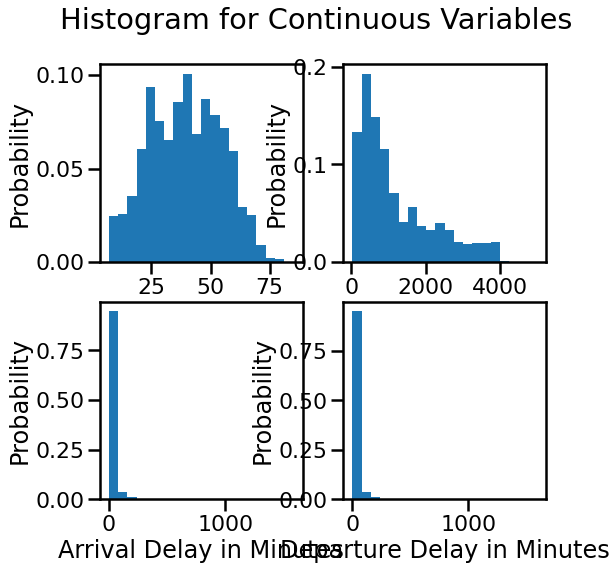

In [105]:
print(train_data[cont_vars].describe())

fig, ax = plt.subplots((len(cont_vars)+1)//2,2)
for _i, _v in enumerate(cont_vars):
    ax[_i//2, _i%2].hist(train_data[_v], weights=np.ones_like(train_data[_v])/train_data[_v].size,  bins=20)
    ax[_i//2, _i%2].set_xlabel(_v)
    ax[_i//2, _i%2].set_ylabel('Probability')
fig.suptitle('Histogram for Continuous Variables')
fig.set_figwidth(8)
fig.set_figheight(8)

#Couple Notes on Distributions: 
# i) Departure and Arrival distributions seem to have most of their mass at or around zero, however tend to also have large outliers. We might want to keep this in mind in the future.

**Explore Categorical Numerical Variables**



       Inflight wifi service  Departure/Arrival time convenient  \
count          103904.000000                      103904.000000   
mean                2.729683                           3.060296   
std                 1.327829                           1.525075   
min                 0.000000                           0.000000   
25%                 2.000000                           2.000000   
50%                 3.000000                           3.000000   
75%                 4.000000                           4.000000   
max                 5.000000                           5.000000   

       Ease of Online booking  Gate location  Food and drink  Online boarding  \
count           103904.000000  103904.000000   103904.000000    103904.000000   
mean                 2.756901       2.976883        3.202129         3.250375   
std                  1.398929       1.277621        1.329533         1.349509   
min                  0.000000       0.000000        0.000000         0.0

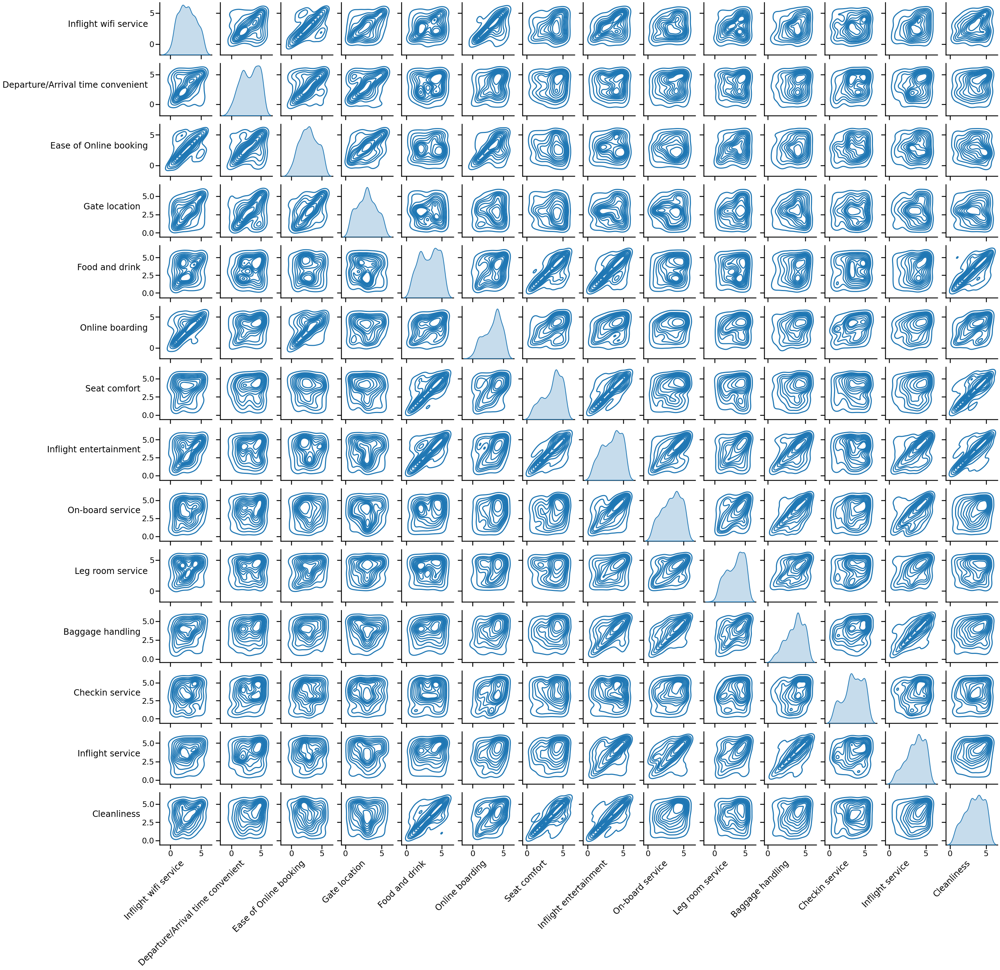

In [106]:
print(train_data[cat_nums].describe())

_ = sns.pairplot(train_data[cat_nums].sample(200), kind='kde')
fig.set_figwidth(20)
fig.set_figheight(20)
for _ax in _.axes.flatten():
    _ax.set_xlabel(_ax.get_xlabel(), rotation = 45)
    _ax.set_ylabel(_ax.get_ylabel(), rotation = 0)
    _ax.xaxis.get_label().set_horizontalalignment('right')
    _ax.yaxis.get_label().set_horizontalalignment('right')
sns.set_context('poster')

#Couple of notes on distributions:
# i) Most distributions look unimodal a mean above 3 (the mean of uniform excluding 0's.) This may bring up questions as to whether or not there might be enough room to be able to measure improvements in services.
# ii) Bimodal distributions generally indicate there are two different populations (examples here: Food & Drink, Ease of Online Booking) and could disappear when looked from a different population conditioning (e.g. Class, Age) These in turn can help indicate pockets of demographics where impacts of an improvement could be higher.



**Explore Categorical String Variables**


In [107]:
cat_vars = ['Gender', 'Customer Type', 'Type of Travel', 'Class', 'satisfaction']
df_cat_cnts = train_data[cat_vars].value_counts().reset_index().sort_values(by=['satisfaction', 'Class', 'Type of Travel', 'Customer Type', 'Gender'])
df_cat_cnts.rename(columns = {0:'Group Count'}, inplace=True)

print("String Variable Categories ({0:d}) and Count".format(df_cat_cnts.shape[0]))
df_cat_cnts

String Variable Categories (43) and Count


,Gender,Customer Type,Type of Travel,Class,satisfaction,Group Count
5,Female,Loyal Customer,Business travel,Business,neutral or dissatisfied,4449
6,Male,Loyal Customer,Business travel,Business,neutral or dissatisfied,4407
10,Female,disloyal Customer,Business travel,Business,neutral or dissatisfied,2316
13,Male,disloyal Customer,Business travel,Business,neutral or dissatisfied,2120
21,Female,Loyal Customer,Personal Travel,Business,neutral or dissatisfied,938
20,Male,Loyal Customer,Personal Travel,Business,neutral or dissatisfied,944
40,Female,disloyal Customer,Personal Travel,Business,neutral or dissatisfied,7
41,Male,disloyal Customer,Personal Travel,Business,neutral or dissatisfied,4
9,Female,Loyal Customer,Business travel,Eco,neutral or dissatisfied,2497
8,Male,Loyal Customer,Business travel,Eco,neutral or dissatisfied,2500


Couple observations from above: 

1) Each categorical string variable seems to have a small number of categories: 3 for Class and 2 each for the remaining 4. 
2) There doesn't seem to be empty values in categorical fields.

3) A closer look at the data shows that there should be 48 separate categorical groups: 3^1*2^4=48. Yet, there are 43 rows. 

Missing categories are as follows and it looks like we're missing 'disloyal Customer's engaging in 'Personal Travel' for 'Business' or 'Eco Plus' Classes of almost both Genders. It might be useful to know for analysis in the future. It might also be good to come up with count estimates of missing values.

In [108]:
def make_cartesian(df, cat_vars):
    """Function to create a Cartesion product of given categorical variables (cat_vars) in a dataframe (df)"""
    c = pd.DataFrame()
    for col in cat_vars:
        uniq_vals = df[col].unique()
        if len(c)==0:
            c = pd.DataFrame(data=uniq_vals, columns=[col])
        else:
            c = c.merge(pd.DataFrame(data=uniq_vals, columns=[col]), how='cross')
    return c

df_all_cats = make_cartesian(df_cat_cnts, cat_vars)

df_diff_cats = pd.DataFrame(columns=df_all_cats.columns) #initialize with no data

_df = pd.concat([df_all_cats, df_cat_cnts[cat_vars]])

for _ in _df.groupby(list(_df.columns)):
    if len(_[1]) == 1:
        df_diff_cats = pd.concat([df_diff_cats,_[1]])

print("Missing Category Groups")
df_diff_cats

#Missing categories are below.

Missing Category Groups


,Gender,Customer Type,Type of Travel,Class,satisfaction
19,Female,disloyal Customer,Personal Travel,Business,satisfied
22,Female,disloyal Customer,Personal Travel,Eco Plus,neutral or dissatisfied
23,Female,disloyal Customer,Personal Travel,Eco Plus,satisfied
43,Male,disloyal Customer,Personal Travel,Business,satisfied
47,Male,disloyal Customer,Personal Travel,Eco Plus,satisfied


In [109]:
_df_melt = pd.melt(train_data[cat_vars], var_name='Category', value_name='Cat_Value')
_df_melt.head()


_df_cat_marg = _df_melt.pivot_table(index=['Category',  'Cat_Value'], aggfunc=lambda x: len(x)/len(train_data)).reset_index()
_df_cat_marg.rename(columns={0: 'Cat_Value in Category Ratio'}, inplace=True)
_df_cat_marg


,Category,Cat_Value,Cat_Value in Category Ratio
0,Class,Business,0.477989
1,Class,Eco,0.449886
2,Class,Eco Plus,0.072124
3,Customer Type,Loyal Customer,0.817322
4,Customer Type,disloyal Customer,0.182678
5,Gender,Female,0.507459
6,Gender,Male,0.492541
7,Type of Travel,Business travel,0.689627
8,Type of Travel,Personal Travel,0.310373
9,satisfaction,neutral or dissatisfied,0.566667


Takina a closer look at data above shows us that Gender, Customer Type, Type of Travel, Class and Satisfaction are Categorical variables (some possibly Ordinal in some sense). Next, we will look at the data range of these variables and see how we could represent them as numbers rather than strings.

**Map Categorical String Variables**

Here, we map the categorical string variables to numerical values for use in our models.

In [112]:
       
gender_dict = dict([('Male',0), ('Female',1)])
cust_type_dict = dict([('disloyal Customer', 0), ('Loyal Customer', 1)])
travel_dict = dict([('Personal Travel',0), ('Business travel',1)])
class_dict = dict([('Eco',0),('Eco Plus',1), ('Business',2)])
sat_dict = dict([('neutral or dissatisfied',0), ('satisfied',1)])

category_dict = dict([('Gender', gender_dict),
                     ('Customer Type', cust_type_dict),
                     ('Type of Travel', travel_dict),
                     ('Class', class_dict),
                     ('satisfaction', sat_dict)])

# for _ in category_dict.items():
#     print(_)


In [114]:
train_data_num = train_data.copy()

for _ in cat_vars:
        train_data_num[_] = train_data_num[_].map(lambda x: category_dict[_][x])


#Let's also do the same for test_data without peeking...
test_data = pd.read_csv("data/raw/test.csv")
test_data.drop(['Unnamed: 0', 'id'], axis=1, inplace=True)
test_data_num = test_data.copy()
for _ in cat_vars:
        test_data_num[_] = test_data_num[_].map(lambda x: category_dict[_][x])

print(train_data_num.dtypes)

#Save both train and test variables:
pd.to_pickle(train_data_num, 'data/model/train_data_num.pkl')
pd.to_pickle(test_data_num, 'data/model/test_data_num.pkl')


Gender                                 int64
Customer Type                          int64
Age                                    int64
Type of Travel                         int64
Class                                  int64
Flight Distance                        int64
Inflight wifi service                  int64
Departure/Arrival time convenient      int64
Ease of Online booking                 int64
Gate location                          int64
Food and drink                         int64
Online boarding                        int64
Seat comfort                           int64
Inflight entertainment                 int64
On-board service                       int64
Leg room service                       int64
Baggage handling                       int64
Checkin service                        int64
Inflight service                       int64
Cleanliness                            int64
Departure Delay in Minutes             int64
Arrival Delay in Minutes             float64
satisfacti

<h2>Part 4: Modeling</h2>

In [ ]:
Up until here.... Next Step Modeling.

**Data Wrangling

In [34]:
report = train_data_num.profile_report(sort='None', html={'style':{'full_width': True}}, progress_bar=True)
report

Summarize dataset:   0%|          | 0/38 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [40]:

categorical_ex_Gender = set(categorical_vars).difference(['Gender'])
print(categorical_ex_Gender)

for _ in train_data[categorical_vars].groupby(list(categorical_ex_Gender)):
    print(_[1].value_counts())



{'Type of Travel', 'satisfaction', 'Class', 'Customer Type'}
Gender  Customer Type   Type of Travel   Class     satisfaction           
Female  Loyal Customer  Business travel  Business  neutral or dissatisfied    4449
Male    Loyal Customer  Business travel  Business  neutral or dissatisfied    4407
dtype: int64
Gender  Customer Type      Type of Travel   Class     satisfaction           
Female  disloyal Customer  Business travel  Business  neutral or dissatisfied    2316
Male    disloyal Customer  Business travel  Business  neutral or dissatisfied    2120
dtype: int64
Gender  Customer Type   Type of Travel   Class  satisfaction           
Male    Loyal Customer  Business travel  Eco    neutral or dissatisfied    2500
Female  Loyal Customer  Business travel  Eco    neutral or dissatisfied    2497
dtype: int64
Gender  Customer Type      Type of Travel   Class  satisfaction           
Female  disloyal Customer  Business travel  Eco    neutral or dissatisfied    5042
Male    disloyal Cu

In [35]:
train_data_num.describe()

,Unnamed: 0,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
count,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,...,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103594.000000,103904.000000
mean,51951.500000,64924.210502,0.507459,0.817322,39.379706,0.689627,1.028103,1189.448375,2.729683,3.060296,...,3.358158,3.382363,3.351055,3.631833,3.304290,3.640428,3.286351,14.815618,15.178678,0.433333
std,29994.645522,37463.812252,0.499947,0.386404,15.114964,0.462649,0.962858,997.147281,1.327829,1.525075,...,1.332991,1.288354,1.315605,1.180903,1.265396,1.175663,1.312273,38.230901,38.698682,0.495538
min,0.000000,1.000000,0.000000,0.000000,7.000000,0.000000,0.000000,31.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,25975.750000,32533.750000,0.000000,1.000000,27.000000,0.000000,0.000000,414.000000,2.000000,2.000000,...,2.000000,2.000000,2.000000,3.000000,3.000000,3.000000,2.000000,0.000000,0.000000,0.000000
50%,51951.500000,64856.500000,1.000000,1.000000,40.000000,1.000000,1.000000,843.000000,3.000000,3.000000,...,4.000000,4.000000,4.000000,4.000000,3.000000,4.000000,3.000000,0.000000,0.000000,0.000000
75%,77927.250000,97368.250000,1.000000,1.000000,51.000000,1.000000,2.000000,1743.000000,4.000000,4.000000,...,4.000000,4.000000,4.000000,5.000000,4.000000,5.000000,4.000000,12.000000,13.000000,1.000000
max,103903.000000,129880.000000,1.000000,1.000000,85.000000,1.000000,2.000000,4983.000000,5.000000,5.000000,...,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,1592.000000,1584.000000,1.000000


In [78]:
features = list(train_data_num.columns)[2:]
print(features)

['Gender', 'Customer Type', 'Age', 'Type of Travel', 'Class', 'Flight Distance', 'Inflight wifi service', 'Departure/Arrival time convenient', 'Ease of Online booking', 'Gate location', 'Food and drink', 'Online boarding', 'Seat comfort', 'Inflight entertainment', 'On-board service', 'Leg room service', 'Baggage handling', 'Checkin service', 'Inflight service', 'Cleanliness', 'Departure Delay in Minutes', 'Arrival Delay in Minutes', 'satisfaction']


[-1.22112747e-02  1.87638171e-01  1.37167305e-01  4.49000450e-01
  4.94471465e-01  2.98779786e-01  2.84245047e-01 -5.16006177e-02
  1.71704978e-01  6.82027456e-04  2.09936240e-01  5.03557322e-01
  3.49458758e-01  3.98059421e-01  3.22382521e-01  3.13130802e-01
  2.47749365e-01  2.36173743e-01  2.44740739e-01  3.05198012e-01
 -5.04942103e-02             nan  1.00000000e+00]
23


Text(0.5, 1.0, 'Correlation of Satisfaction Among All Surveytakers')

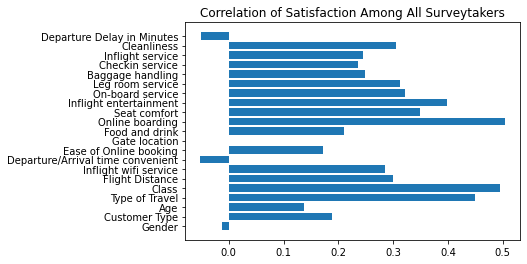

In [93]:
sat_corr = np.corrcoef(train_data_num.loc[:,features].T)
print(sat_corr[:,-1])
print(len(features))
plt.barh(y = features[:-2], width = sat_corr[:-2,-1])
plt.title('Correlation of Satisfaction Among All Surveytakers')

In [ ]:
sat_corr = np.corrcoef(train_data_num.loc[:,features].T)
print(sat_corr[:,-1])
print(len(features))
plt.barh(y = features[:-2], width = sat_corr[:-2,-1])
plt.title('Correlation of Satisfaction Among All Surveytakers')

In [94]:
#convert objects into categories
train_data_cat = train_data.copy()
_object_dtype = train_data_cat.dtypes == 'object'
train_data_cat.loc[:, _object_dtype]  = train_data.loc[:,_object_dtype].apply(lambda _: _.astype('category'))
print(train_data_cat.dtypes)
print(train_data_cat.loc[:, train_data.dtypes=='category'].info())

Unnamed: 0                              int64
id                                      int64
Gender                               category
Customer Type                        category
Age                                     int64
Type of Travel                       category
Class                                category
Flight Distance                         int64
Inflight wifi service                   int64
Departure/Arrival time convenient       int64
Ease of Online booking                  int64
Gate location                           int64
Food and drink                          int64
Online boarding                         int64
Seat comfort                            int64
Inflight entertainment                  int64
On-board service                        int64
Leg room service                        int64
Baggage handling                        int64
Checkin service                         int64
Inflight service                        int64
Cleanliness                       

In [144]:
#insert dummies 

train_data_dummies = train_data_cat.copy()

for _ in train_data_dummies.select_dtypes(include=['category']):
#     print(_)
#     print(train_data_cat[_].dtype=='category')
    dummies = pd.get_dummies(train_data_dummies[_],prefix=_)
    train_data_dummies = pd.concat([train_data_dummies, dummies],axis=1)
    train_data_dummies.drop([_],axis=1,inplace=True)
train_data_dummies.head()  

,Unnamed: 0,id,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,...,Gender_Male,Customer Type_Loyal Customer,Customer Type_disloyal Customer,Type of Travel_Business travel,Type of Travel_Personal Travel,Class_Business,Class_Eco,Class_Eco Plus,satisfaction_neutral or dissatisfied,satisfaction_satisfied
0,0,70172,13,460,3,4,3,1,5,3,...,1,1,0,0,1,0,0,1,1,0
1,1,5047,25,235,3,2,3,3,1,3,...,1,0,1,1,0,1,0,0,1,0
2,2,110028,26,1142,2,2,2,2,5,5,...,0,1,0,1,0,1,0,0,0,1
3,3,24026,25,562,2,5,5,5,2,2,...,0,1,0,1,0,1,0,0,1,0
4,4,119299,61,214,3,3,3,3,4,5,...,1,1,0,1,0,1,0,0,0,1


In [150]:
non_target_cats = [_ for _ in train_data_cat.select_dtypes(include=['category']) if _!='satisfaction']
print(non_target_cats)
for _ in non_target_cats:
    _cats = train_data_cat[_].cat.categories
    print(_cats)

['Gender', 'Customer Type', 'Type of Travel', 'Class']
Index(['Female', 'Male'], dtype='object')
Index(['Loyal Customer', 'disloyal Customer'], dtype='object')
Index(['Business travel', 'Personal Travel'], dtype='object')
Index(['Business', 'Eco', 'Eco Plus'], dtype='object')


In [ ]:
for